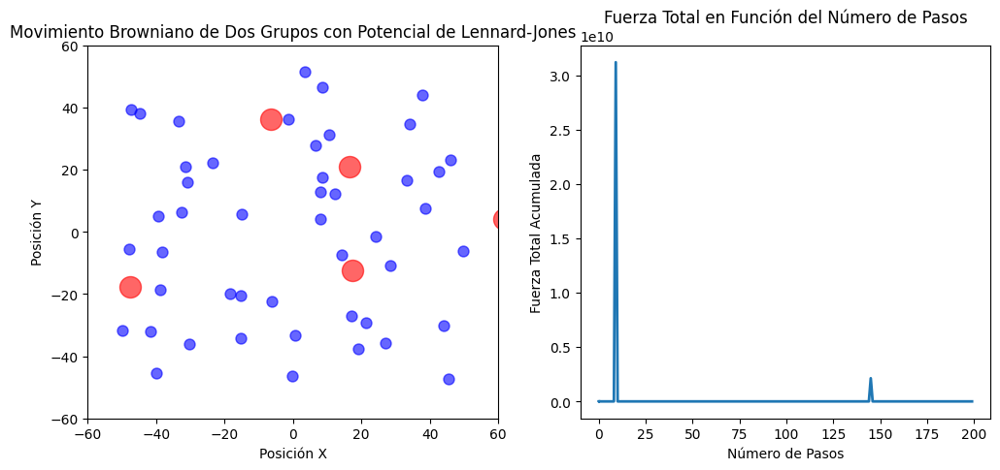

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parámetros de la simulación
num_particulas_grupo1 = 50  # Número de partículas en el grupo 1
num_particulas_grupo2 = 10  # Número de partículas en el grupo 2
num_pasos = 200    # Número de pasos de tiempo
dt = 0.1              # Tamaño del paso de tiempo
diffusion_coefficient = 0.5  # Coeficiente de difusión

# Parámetros del pH común para ambos grupos
pH_comun = 7.0  # pH común para ambos grupos
k_H = 1e-7  # Constante de ionización del agua (para pH neutro)

# Factores de carga intrínsecos para cada grupo
factor_carga_grupo1 = 1.0
factor_carga_grupo2 = 0.8

# Inicialización de posiciones iniciales aleatorias para ambos grupos
posiciones_grupo1 = np.random.uniform(low=-50, high=50, size=(num_particulas_grupo1, 2))
posiciones_grupo2 = np.random.uniform(low=-50, high=50, size=(num_particulas_grupo2, 2))

# Inicialización de las cargas para cada partícula en cada grupo
cargas_grupo1 = factor_carga_grupo1 * np.sinh(np.log(10) * (pH_comun - 7)) * np.ones(num_particulas_grupo1)
cargas_grupo2 = factor_carga_grupo2 * np.sinh(np.log(10) * (pH_comun - 7)) * np.ones(num_particulas_grupo2)

# Viscosidad del medio (supuesta la misma para ambos grupos)
viscosity = 0.01

# Radios de las partículas
radio_grupo1 = 1.0
radio_grupo2 = 2.0 * radio_grupo1

# Parámetros del potencial de Lennard-Jones
epsilon = 1.0
sigma = 1.0

# Arrays para almacenar la fuerza total y el paso de tiempo
fuerza_total = []
pasos_de_tiempo = []

# Crear figura y ejes para la animación
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
ax[0].set_xlim(-60, 60)
ax[0].set_ylim(-60, 60)
ax[0].set_xlabel('Posición X')
ax[0].set_ylabel('Posición Y')
ax[0].set_title('Movimiento Browniano de Dos Grupos con Potencial de Lennard-Jones')

# Inicialización del gráfico (puntos vacíos) para la animación
puntos1 = ax[0].scatter(posiciones_grupo1[:, 0], posiciones_grupo1[:, 1], s=np.pi * (radio_grupo1**2) * 20, c='blue', alpha=0.6)
puntos2 = ax[0].scatter(posiciones_grupo2[:, 0], posiciones_grupo2[:, 1], s=np.pi * (radio_grupo2**2) * 20, c='red', alpha=0.6)

# Inicialización de la gráfica de fuerza total en función de los pasos
linea_fuerza_total, = ax[1].plot([], [], lw=2)
ax[1].set_xlabel('Número de Pasos')
ax[1].set_ylabel('Fuerza Total Acumulada')
ax[1].set_title('Fuerza Total en Función del Número de Pasos')

# Función de animación para actualizar las posiciones en cada paso de tiempo
def animate(i):
    global posiciones_grupo1, posiciones_grupo2, fuerza_total, pasos_de_tiempo
    
    # Generar el ruido (movimiento aleatorio) con distribución normal
    ruido1 = np.sqrt(2 * diffusion_coefficient * dt) * np.random.randn(num_particulas_grupo1, 2)
    ruido2 = np.sqrt(2 * diffusion_coefficient * dt) * np.random.randn(num_particulas_grupo2, 2)
    
    # Calcular la fuerza total en cada paso de tiempo
    total_force = 0.0
    
    # Calcular la interacción con el fluido según la carga y la posición (suponiendo la misma interacción para ambos grupos)
    for j in range(num_particulas_grupo1):
        for k in range(num_particulas_grupo2):
            # Distancia entre las partículas j del grupo 1 y k del grupo 2
            distancia1 = np.linalg.norm(posiciones_grupo1[j] - posiciones_grupo2[k])
            
            # Calcular fuerza de Lennard-Jones
            if distancia1 < 1e-6:
                fuerza_lj1 = np.zeros(2)
            else:
                fuerza_lj1 = 24 * epsilon * (2 * (sigma / distancia1)**12 - (sigma / distancia1)**6) * (posiciones_grupo1[j] - posiciones_grupo2[k]) / distancia1**2
            
            # Calcular fuerza de Coulomb para el grupo 1
            distancia_al_origen1 = np.linalg.norm(posiciones_grupo1[j])
            fuerza_coulomb1 = cargas_grupo1[j] / (4 * np.pi * viscosity * distancia_al_origen1**3)
            fuerza_coulomb1 *= posiciones_grupo1[j]
            
            # Actualizar las posiciones del grupo 1 con el ruido, la fuerza de Coulomb y la fuerza de Lennard-Jones
            posiciones_grupo1[j] += ruido1[j] * dt + fuerza_lj1 * dt + fuerza_coulomb1 * dt
            
            # Sumar la fuerza total
            total_force += np.linalg.norm(fuerza_lj1 + fuerza_coulomb1)
    
    for j in range(num_particulas_grupo2):
        for k in range(num_particulas_grupo1):
            # Distancia entre las partículas j del grupo 2 y k del grupo 1
            distancia2 = np.linalg.norm(posiciones_grupo2[j] - posiciones_grupo1[k])
            
            # Calcular fuerza de Lennard-Jones
            if distancia2 < 1e-6:
                fuerza_lj2 = np.zeros(2)
            else:
                fuerza_lj2 = 24 * epsilon * (2 * (sigma / distancia2)**12 - (sigma / distancia2)**6) * (posiciones_grupo2[j] - posiciones_grupo1[k]) / distancia2**2
            
            # Calcular fuerza de Coulomb para el grupo 2
            distancia_al_origen2 = np.linalg.norm(posiciones_grupo2[j])
            fuerza_coulomb2 = cargas_grupo2[j] / (4 * np.pi * viscosity * distancia_al_origen2**3)
            fuerza_coulomb2 *= posiciones_grupo2[j]
            
            # Actualizar las posiciones del grupo 2 con el ruido, la fuerza de Coulomb y la fuerza de Lennard-Jones
            posiciones_grupo2[j] += ruido2[j] * dt + fuerza_lj2 * dt + fuerza_coulomb2 * dt
            
            # Sumar la fuerza total
            total_force += np.linalg.norm(fuerza_lj2 + fuerza_coulomb2)
    
    # Guardar la fuerza total en el array para la gráfica
    fuerza_total.append(total_force)
    pasos_de_tiempo.append(i)
    
    # Actualizar los datos de los puntos en el gráfico de animación
    puntos1.set_offsets(posiciones_grupo1)
    puntos2.set_offsets(posiciones_grupo2)
    
    # Actualizar los datos de la gráfica de fuerza total en función de los pasos
    linea_fuerza_total.set_data(pasos_de_tiempo, fuerza_total)
    
    # Ajustar automáticamente los límites de la gráfica de fuerza total para mantener la visualización
    ax[1].relim()
    ax[1].autoscale_view()
    
    return puntos1, puntos2, linea_fuerza_total

# Crear la animación
ani = FuncAnimation(fig, animate, frames=num_pasos, blit=True, interval=50)

# Mostrar la animación en formato HTML para visualización en Jupyter Notebook
HTML(ani.to_jshtml())

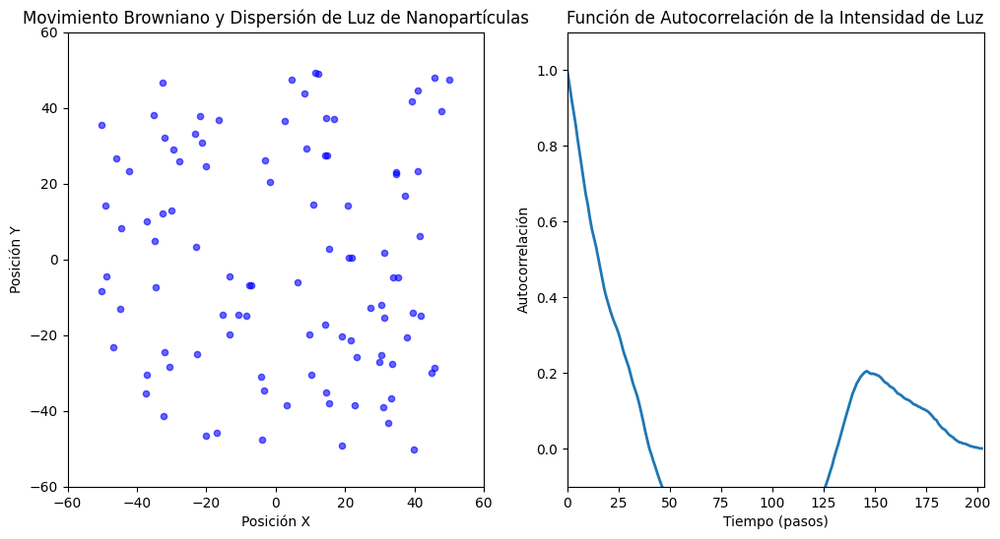

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parámetros de la simulación
num_particulas = 100  # Número de nanopartículas
num_pasos = 200    # Número de pasos de tiempo
dt = 0.1           # Tamaño del paso de tiempo
diffusion_coefficient = 0.5  # Coeficiente de difusión (relacionado con DLS)

# Inicialización de posiciones iniciales aleatorias para las nanopartículas
posiciones = np.random.uniform(low=-50, high=50, size=(num_particulas, 2))
intensidades = []  # Para almacenar la intensidad de la luz dispersada

# Crear figura y ejes para la animación
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Ejes para la simulación
ax[0].set_xlim(-60, 60)
ax[0].set_ylim(-60, 60)
ax[0].set_xlabel('Posición X')
ax[0].set_ylabel('Posición Y')
ax[0].set_title('Movimiento Browniano y Dispersión de Luz de Nanopartículas')

# Inicialización del gráfico de puntos para la animación
puntos = ax[0].scatter(posiciones[:, 0], posiciones[:, 1], s=20, c='blue', alpha=0.6)

# Ejes para la autocorrelación de la intensidad
ax[1].set_xlim(0, num_pasos)
ax[1].set_ylim(-0.1, 1.1)
ax[1].set_xlabel('Tiempo (pasos)')
ax[1].set_ylabel('Autocorrelación')
ax[1].set_title('Función de Autocorrelación de la Intensidad de Luz')

# Inicialización de la gráfica de autocorrelación
linea_autocorrelacion, = ax[1].plot([], [], lw=2)

# Función para calcular la autocorrelación
def autocorrelacion(x):
    n = len(x)
    resultado = np.correlate(x - np.mean(x), x - np.mean(x), mode='full')
    resultado = resultado[n-1:] / resultado[n-1]
    return resultado

# Función para calcular la intensidad de luz dispersada
def calcular_intensidad(posiciones):
    q = 1.0  # Vector de dispersión relacionado con el ángulo de detección
    intensidad = np.sum(np.exp(1j * q * posiciones[:, 0]))  # Intensidad de la luz dispersada
    return np.abs(intensidad)**2  # Intensidad real

# Función de animación para actualizar las posiciones y la gráfica de autocorrelación
def animate(i):
    global posiciones, intensidades
    
    # Generar el ruido (movimiento browniano)
    ruido = np.sqrt(2 * diffusion_coefficient * dt) * np.random.randn(num_particulas, 2)
    
    # Actualizar las posiciones
    posiciones += ruido * dt
    
    # Calcular la intensidad de la luz dispersada en este paso
    intensidad = calcular_intensidad(posiciones)
    intensidades.append(intensidad)
    
    # Calcular la autocorrelación en función del tiempo
    if len(intensidades) > 1:
        autocorr = autocorrelacion(intensidades)
        linea_autocorrelacion.set_data(range(len(autocorr)), autocorr)
        ax[1].set_xlim(0, len(autocorr))
    
    # Actualizar los datos de los puntos en el gráfico de animación
    puntos.set_offsets(posiciones)
    
    return puntos, linea_autocorrelacion

# Crear la animación
ani = FuncAnimation(fig, animate, frames=num_pasos, blit=True, interval=50)

# Mostrar la animación en formato HTML para visualización en Jupyter Notebook
HTML(ani.to_jshtml())
